In [9]:
import numpy as np
import torch
import data_making.dataset as dataset
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import results
import os
import trimesh
from mesh_to_sdf import sample_sdf_near_surface
import data
from utils import utils
import meshplot as mp
from data_making.extract_data import *
import argparse
from mesh_to_sdf.surface_point_cloud import *

### PartNet Mobility extracted with my functions

In [10]:
data_set = dataset.SDFDataset()

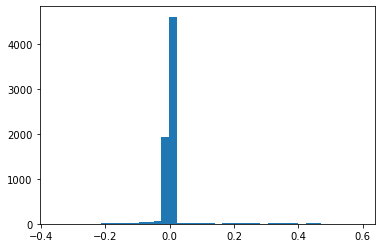

In [25]:
sdf = np.array(data_set[7000:14000][1].view(-1))
plt.hist(sdf, bins=40)
plt.show()

In [26]:
coords_latent = data_set[7000:14000][0]
points = coords_latent[:, 1:]
sdf = data_set[7000:14000][1]

In [27]:
np.where(sdf < 0)[0]

array([   0,    1,    2, ..., 6997, 6998, 6999])

In [28]:
negative_indexes = np.where(sdf < 0)[0]
positive_indexes = np.where(sdf > 0)[0]

negative_sdf_points = points[negative_indexes]
positive_sdf_points = points[positive_indexes]

print(f'Number of positive coordinates: {positive_sdf_points.shape[0]}')
print(f'Number of negative coordinates: {negative_sdf_points.shape[0]}')

fig = go.Figure(
    [
        go.Scatter3d(x=negative_sdf_points[:, 0], 
             y=negative_sdf_points[:, 1],
             z=negative_sdf_points[:, 2], 
             mode='markers', marker=dict(size=2)),
        go.Scatter3d(x=positive_sdf_points[:, 0], 
             y=positive_sdf_points[:, 1],
             z=positive_sdf_points[:, 2], 
             mode='markers', marker=dict(size=2, color='orange')
            )
    ]
)
fig.show()

Number of positive coordinates: 4579
Number of negative coordinates: 2421


The problem is that only a tiny fraction of the overall points is associated with a negative sdf. A possible solution is to sample more points near the negative samples and only keep the negative ones.

In [ ]:
negative_sdf_points.shape

In [ ]:
objs_dict = np.load(os.path.join(os.path.dirname(results.__file__), 'objs_dict.npy'), allow_pickle=True).item()
objs_dict.keys()

In [ ]:
objs_dict = np.load(os.path.join(os.path.dirname(results.__file__), 'objs_dict.npy'), allow_pickle=True).item()
obj_idx = '102505'
mesh = trimesh.Trimesh(objs_dict[obj_idx]['verts'], objs_dict[obj_idx]['faces'])


In [ ]:
sigma = 0.01
spc = create_from_scans(mesh)

for i in range(4):
    additional_negatives = np.random.normal(0, sigma, size=(negative_sdf_points.shape[0] * negative_sdf_points.shape[1]))
    temp_negative_sdf_points = negative_sdf_points + additional_negatives.reshape(negative_sdf_points.shape[0], negative_sdf_points.shape[1]) 
    print(temp_negative_sdf_points)
    sdf = spc.get_sdf_in_batches(temp_negative_sdf_points, use_depth_buffer=True)
    new_neg_points = temp_negative_sdf_points[sdf<0]
    negative_sdf_points = np.vstack((negative_sdf_points, new_neg_points))


In [14]:
# doppia only points at the surface
coords_latent = data_set[50000:100000][0]
points = coords_latent[:, 1:]
sdf = data_set[50000:100000][1]

negative_indexes = np.where(sdf < 0)[0]
positive_indexes = np.where(sdf > 0)[0]

negative_sdf_points = points[negative_indexes]
positive_sdf_points = points[positive_indexes]

print(f'Number of positive coordinates: {positive_sdf_points.shape[0]}')
print(f'Number of negative coordinates: {negative_sdf_points.shape[0]}')

surface_indexes = np.where((sdf > -0.01) & (sdf < 0.01))[0]
points_on_surface = points[surface_indexes]

fig = go.Figure(
    [
        go.Scatter3d(x=points_on_surface[:, 0], 
                     y=points_on_surface[:, 1],
                     z=points_on_surface[:, 2], 
                     mode='markers', marker=dict(size=2))
    ]
)
fig.show()
sdf_on_surface = sdf[surface_indexes]

objs_dict = np.load(os.path.join(os.path.dirname(results.__file__), 'objs_dict.npy'), allow_pickle=True).item()
obj_idx = '102505'
mesh = trimesh.Trimesh(objs_dict[obj_idx]['verts'], objs_dict[obj_idx]['faces'])
spc = create_from_scans(mesh)
sigma = 0.05

for _ in range(2):
    additional_points = torch.normal(0, sigma, size=(points_on_surface.shape[0] * points_on_surface.shape[1], ))
    temp_points = points_on_surface + additional_points.view(points_on_surface.shape[0], points_on_surface.shape[1]) 
    temp_sdf = torch.tensor(spc.get_sdf_in_batches(temp_points, use_depth_buffer=True))
    new_neg_points = temp_points[temp_sdf<0]
    new_sdf = temp_sdf[temp_sdf < 0].view(-1, 1)
    sdf = np.vstack((sdf, new_sdf))
    points = torch.vstack((points, new_neg_points))
    surface_indexes = np.where((sdf > -0.01) & (sdf < 0.01))[0]
    points_on_surface = points[surface_indexes]
    
negative_indexes = np.where(sdf < 0)[0]
positive_indexes = np.where(sdf > 0)[0]

negative_sdf_points = points[negative_indexes]
positive_sdf_points = points[positive_indexes]

print(f'Number of new positive coordinates: {positive_sdf_points.shape[0]}')
print(f'Number of new negative coordinates: {negative_sdf_points.shape[0]}')

fig = go.Figure(
    [
        go.Scatter3d(x=negative_sdf_points[:, 0], 
                     y=negative_sdf_points[:, 1],
                     z=negative_sdf_points[:, 2], 
                     mode='markers', marker=dict(size=2)),
        go.Scatter3d(x=positive_sdf_points[:, 0], 
                     y=positive_sdf_points[:, 1],
                     z=positive_sdf_points[:, 2], 
                     mode='markers', marker=dict(size=2, color='orange'))
    ]
)
fig.show()

Number of positive coordinates: 45862
Number of negative coordinates: 4138


Number of new positive coordinates: 45862
Number of new negative coordinates: 41860


### PartNet Mobility with Marian's function

In [ ]:
objs_dict = np.load(os.path.join(os.path.dirname(results.__file__), 'objs_dict.npy'), allow_pickle=True).item()

In [ ]:
obj = objs_dict['102763']
verts = obj['verts']
faces = obj['faces']

In [ ]:
mesh = trimesh.Trimesh(verts, faces)
points, sdf = sample_sdf_near_surface(mesh, number_of_points=50000, sign_method='depth')

In [ ]:
plt.hist(sdf, bins=40)
plt.show()

In [ ]:
negative_indexes = np.where(sdf < 0)
positive_indexes = np.where(sdf > 0.001)

negative_sdf_points = points[negative_indexes]
positive_sdf_points = points[positive_indexes]

In [ ]:
fig = go.Figure(
    [
        go.Scatter3d(x=negative_sdf_points[:, 0], 
             y=negative_sdf_points[:, 1],
             z=negative_sdf_points[:, 2], 
             mode='markers', marker=dict(size=2)),
        go.Scatter3d(x=positive_sdf_points[:, 0], 
             y=positive_sdf_points[:, 1],
             z=positive_sdf_points[:, 2], 
             mode='markers', marker=dict(size=2, color='orange')
            )
    ]
)
fig.show()

### ShapeNet with my function

In [ ]:
obj_path = os.path.join(os.path.dirname(data.__file__), 'shapenet_obj', '1b29de0b8be4b18733d25da891be74b8.obj' )
mesh = utils._as_mesh(trimesh.load(obj_path))   # for some reason, they are 2

In [ ]:
mp.plot(mesh.vertices, mesh.faces)

In [ ]:
obj_idx = 0
#trimesh.repair.fix_inversion(mesh)
objs_dict = {0: {'verts': np.asarray(mesh.vertices), 'faces': np.asarray(mesh.faces)}}

class Args:
  num_samples_on_surface = 5000
  num_samples_far_surface = 5000

args=Args()

samples_dict = dict()
samples_dict[obj_idx] = dict()
samples_dict[obj_idx]['samples'] = sample(objs_dict[obj_idx], args)
samples_dict[obj_idx]['sdf'] = compute_sdf(objs_dict[obj_idx]['verts'], objs_dict[obj_idx]['faces'], samples_dict[obj_idx]['samples'])
samples_dict[obj_idx]['latent_class'] = np.array([obj_idx], dtype=np.int32)
samples_dict[obj_idx]['samples_latent_class'] = combine_sample_latent(samples_dict[obj_idx]['samples'], samples_dict[obj_idx]['latent_class'])


In [ ]:
def _debug_plot(samples, dist=True):
    points = samples['samples']
    sdfs = samples['sdf']
    inner = points[sdfs>0]
    outer = points[sdfs<0]

    fig = go.Figure(
        [
            go.Scatter3d(x=inner[:, 0], y=inner[:, 1],z=inner[:, 2], mode='markers', marker=dict(size=2)),
            go.Scatter3d(x=outer[:, 0], y=outer[:, 1],z=outer[:, 2], mode='markers', marker=dict(size=2))
        ]
    )
    fig.show()

_debug_plot(samples_dict[obj_idx]) 


In [ ]:
points, sdf = sample_sdf_near_surface(mesh, sign_method='depth', number_of_points=100000)

In [ ]:
plt.hist(sdf, bins=40)
plt.show()

In [ ]:
negative_indexes = np.where(sdf < 0)
positive_indexes = np.where(sdf > 0)

negative_sdf_points = points[negative_indexes]
positive_sdf_points = points[positive_indexes]

negative_sdf = sdf[negative_indexes]
positive_sdf = sdf[positive_indexes]

In [ ]:
fig = go.Figure(
    [
        go.Scatter3d(x=negative_sdf_points[:, 0], 
             y=negative_sdf_points[:, 1],
             z=negative_sdf_points[:, 2], 
             mode='markers', marker=dict(size=2, color='orange')),
        go.Scatter3d(x=positive_sdf_points[:, 0], 
             y=positive_sdf_points[:, 1],
             z=positive_sdf_points[:, 2], 
             mode='markers', marker=dict(size=2, color='blue')
            )
    ]
)
fig.show()

In [ ]:
np.amin(sdf)

In [32]:
a = np.array([1, 5, 11])
np.where(a < 6)[0]

array([0, 1])